In [ ]:
#!git clone https://github.com/aixiajiao/satesr.git
#%cd satesr

In [ ]:
#!python setup.py

In [2]:
from satesr import satesr

In [43]:
latlon=[30.241447848951147, 120.43300468912736,500]
download_folder='demo/aerial_imgs/airport'

In [45]:
satesr(lat=latlon[0], #latitude    
       lon=latlon[1], #longitude
       radius=500,    #radius of the requested area
       maxlevel=18,   #optinal, detail level of the requested area (1 to 23), higher the better, default at 20.
       path=download_folder, #photo path
       enhance=False,  #optional, image superesolution
       scale=4) 

100%|███████████████████████████████████████████| 8/8 [00:10<00:00,  1.36s/it]

Find the aerial image at level 18, saved as aerialimg_lv18_0817-2248.jpeg in folder demo/aerial_imgs/airport


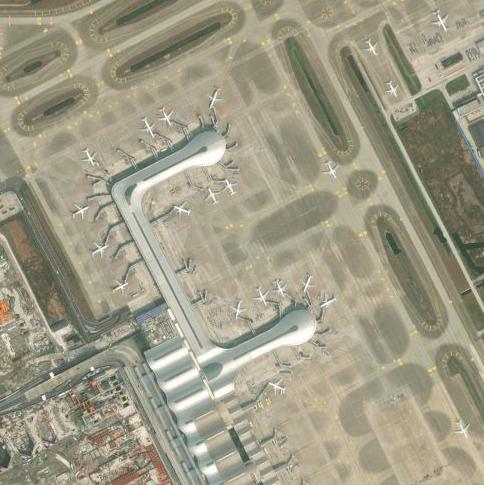

In [46]:
import os
output_images = [os.path.join(download_folder, x) for x in os.listdir(download_folder) if x[-4:] == "jpeg"]
from IPython.display import Image
import random
random_number = random.randint(0, (len(output_images)-1))
Image(output_images[random_number]) 

In [49]:
satesr(enhance=True,scale=4,path=download_folder)

No valid coordinates, SR only
CPU mode, image processing might be slow
Upsampling aerialimg_lv16_0817-2248 , total number of file(s): 1
Finshed, enhanced image(s) saved in demo/aerial_imgs/airport_enhanced


In [47]:
sr_outputfolder=download_folder+'_enhanced'

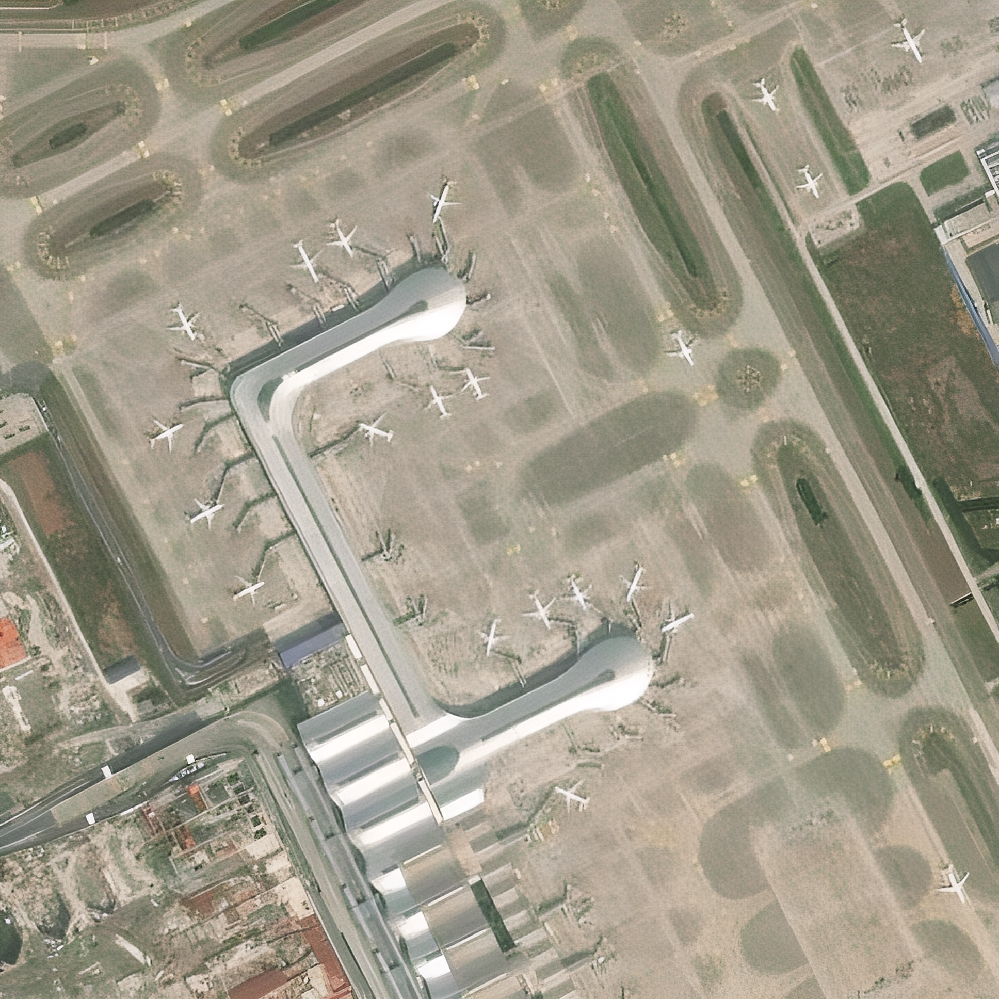

In [50]:
import os
sr_output_images = [os.path.join(sr_outputfolder, x) for x in os.listdir(sr_outputfolder) if x[-4:] == "jpeg"]
from IPython.display import Image
import random
random_number = random.randint(0, (len(sr_output_images)-1))
Image(sr_output_images[random_number]) 

In [ ]:
#!pip install sahi
#!pip install yolov5

In [51]:
from sahi.model import Yolov5DetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

In [52]:
yolov5_model_path = 'models/demo_models/plane_yolov5.pt'

In [53]:
detection_model = Yolov5DetectionModel(
    model_path=yolov5_model_path,
    confidence_threshold=0.25,
    device="cpu", # or 'cuda:0'
)

In [54]:
export_dir='demo/small_object_detection/detect'

In [55]:
output_images

['demo/aerial_imgs/airport/aerialimg_lv16_0817-2248.jpeg',
 'demo/aerial_imgs/airport/aerialimg_lv18_0817-2248.jpeg']

In [56]:
sr_output_images

['demo/aerial_imgs/airport_enhanced/aerialimg_lv16_0817-2248_enhanced.jpeg']

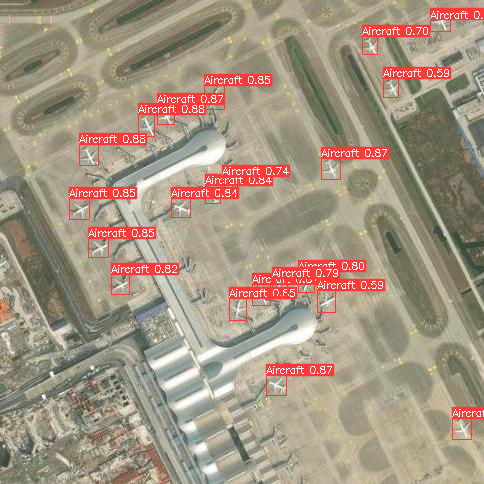

In [63]:
result = get_prediction(read_image(output_images[0]), detection_model)
result.export_visuals(export_dir=export_dir,file_name='od16_straight')
Image(export_dir+'/od16_straight.png')

In [67]:
result.to_coco_annotations()

[{'image_id': None,
  'bbox': [79, 144, 19, 21],
  'score': 0.8794940114021301,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 399},
 {'image_id': None,
  'bbox': [138, 114, 16, 22],
  'score': 0.8794705867767334,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 352},
 {'image_id': None,
  'bbox': [430, 8, 20, 23],
  'score': 0.87514328956604,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 460},
 {'image_id': None,
  'bbox': [266, 375, 20, 20],
  'score': 0.874780535697937,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 400},
 {'image_id': None,
  'bbox': [157, 104, 17, 20],
  'score': 0.8688806295394897,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 340},
 {'image_id': None,
  'bbox': [252, 284, 18, 21],
  'score': 0.8681071400642

In [66]:
result.to_coco_predictions()

[{'image_id': None,
  'bbox': [79, 144, 19, 21],
  'score': 0.8794940114021301,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 399},
 {'image_id': None,
  'bbox': [138, 114, 16, 22],
  'score': 0.8794705867767334,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 352},
 {'image_id': None,
  'bbox': [430, 8, 20, 23],
  'score': 0.87514328956604,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 460},
 {'image_id': None,
  'bbox': [266, 375, 20, 20],
  'score': 0.874780535697937,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 400},
 {'image_id': None,
  'bbox': [157, 104, 17, 20],
  'score': 0.8688806295394897,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 340},
 {'image_id': None,
  'bbox': [252, 284, 18, 21],
  'score': 0.8681071400642

08/17/2022 23:17:24 - WARNING - sahi.slicing -   Starting from version `0.10.2`, `auto_slice_resolution=True` is introduced as the default behavior for determining slice height and width automatically calculated by the image properties (resolution, aspect ratio and orientation).
Starting from version `0.10.2`, `auto_slice_resolution=True` is introduced as the default behavior for determining slice height and width automatically calculated by the image properties (resolution, aspect ratio and orientation).


Performing prediction on 9 number of slices.


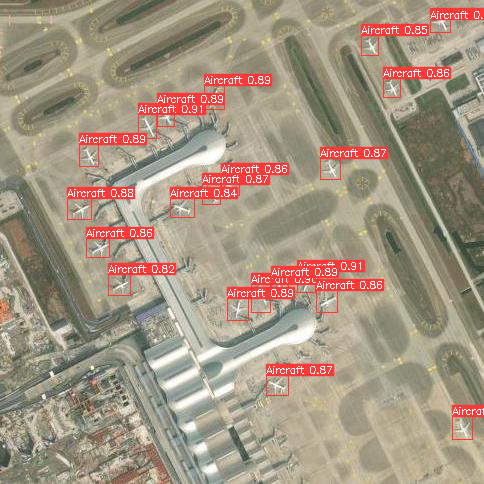

In [58]:
result = get_sliced_prediction(
    output_images[0],
    detection_model,
    slice_height=256,
    slice_width=256,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir=export_dir, file_name='od16_sliced')
Image(export_dir+'/'+'od16_sliced'+'.png')

08/17/2022 23:17:49 - WARNING - sahi.slicing -   Starting from version `0.10.2`, `auto_slice_resolution=True` is introduced as the default behavior for determining slice height and width automatically calculated by the image properties (resolution, aspect ratio and orientation).
Starting from version `0.10.2`, `auto_slice_resolution=True` is introduced as the default behavior for determining slice height and width automatically calculated by the image properties (resolution, aspect ratio and orientation).


Performing prediction on 9 number of slices.


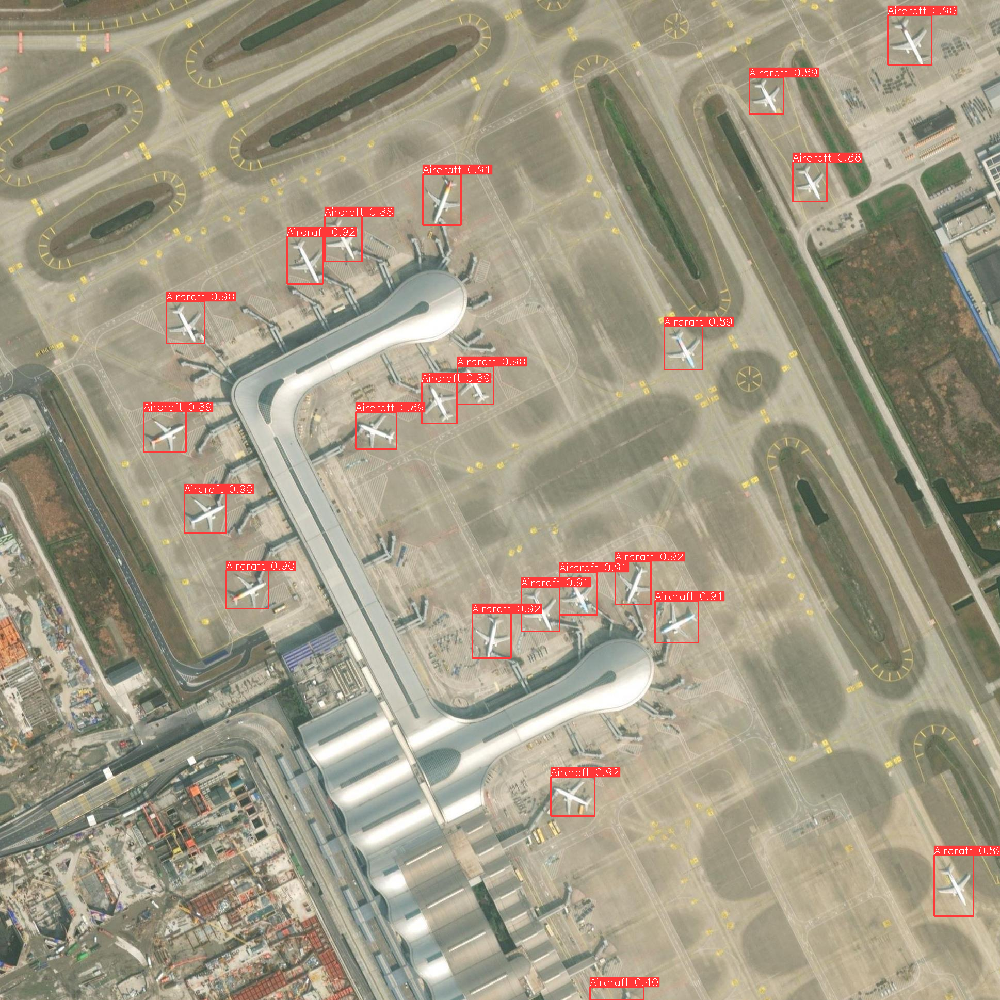

In [60]:
result = get_sliced_prediction(
    output_images[1],
    detection_model,
    slice_height=1024,
    slice_width=1024,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir=export_dir, file_name='od18_sliced')
Image(export_dir+'/'+'od18_sliced'+'.png')

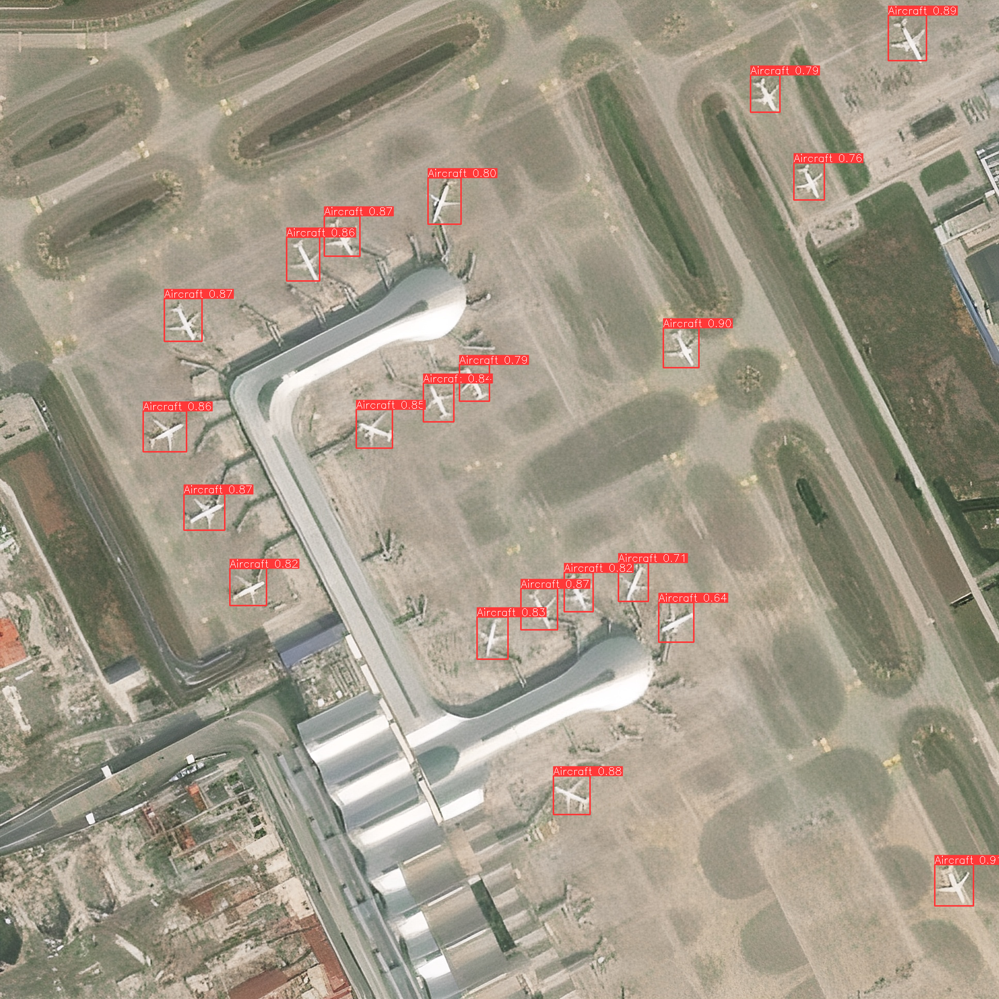

In [68]:
result = get_prediction(read_image(sr_output_images[0]), detection_model)
result.export_visuals(export_dir=export_dir, file_name='od16_enhanced')
Image(export_dir+'/'+'od16_enhanced'+'.png')

In [71]:
result.to_coco_annotations()

[{'image_id': None,
  'bbox': [1009, 1140, 71, 101],
  'score': 0.933175265789032,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 7171},
 {'image_id': None,
  'bbox': [1086, 1109, 63, 76],
  'score': 0.9240937829017639,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 4788},
 {'image_id': None,
  'bbox': [1193, 1087, 64, 82],
  'score': 0.9200965762138367,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 5248},
 {'image_id': None,
  'bbox': [555, 459, 68, 88],
  'score': 0.9199004769325256,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 5984},
 {'image_id': None,
  'bbox': [277, 796, 84, 79],
  'score': 0.9119911789894104,
  'category_id': 0,
  'category_name': 'Aircraft',
  'segmentation': [],
  'iscrowd': 0,
  'area': 6636},
 {'image_id': None,
  'bbox': [1811, 1672, 75, 97],
  'scor

08/18/2022 03:27:32 - WARNING - sahi.slicing -   Starting from version `0.10.2`, `auto_slice_resolution=True` is introduced as the default behavior for determining slice height and width automatically calculated by the image properties (resolution, aspect ratio and orientation).
Starting from version `0.10.2`, `auto_slice_resolution=True` is introduced as the default behavior for determining slice height and width automatically calculated by the image properties (resolution, aspect ratio and orientation).


Performing prediction on 9 number of slices.


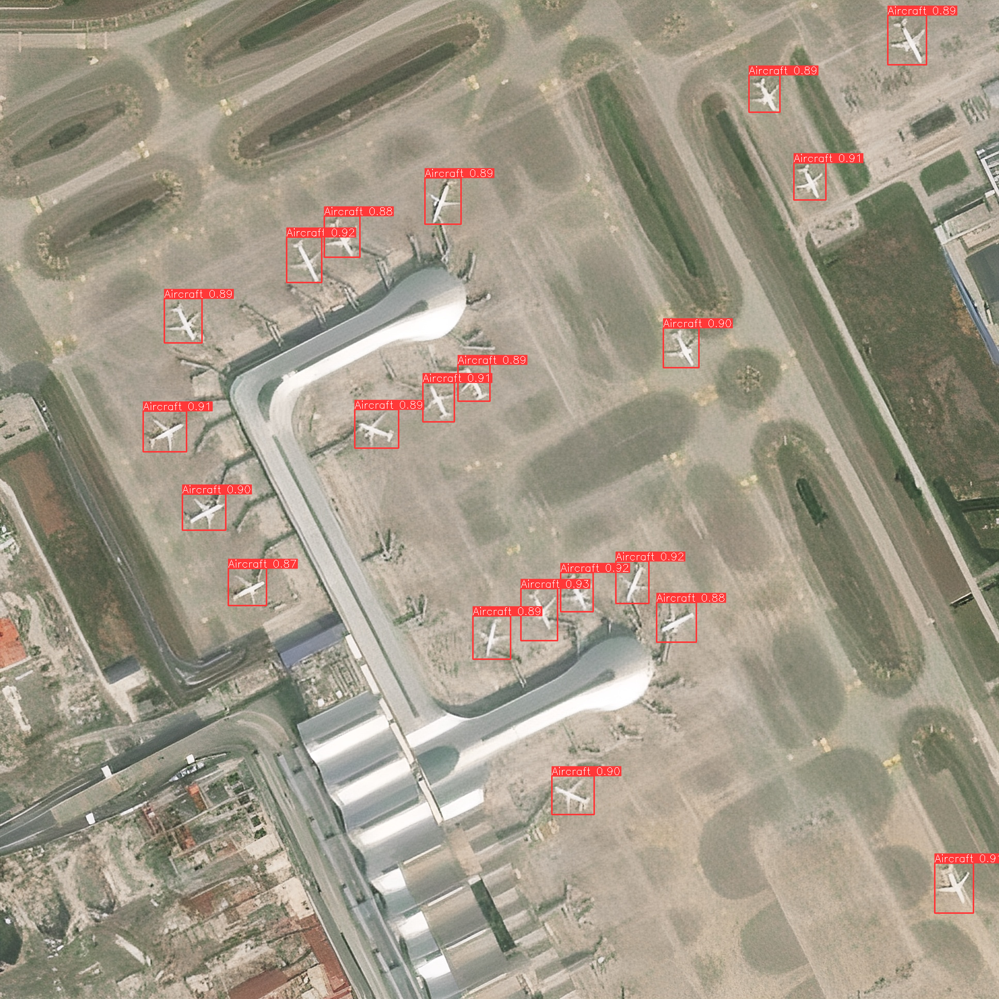

In [70]:
result = get_sliced_prediction(
    sr_output_images[0],
    detection_model,
    slice_height=1024,
    slice_width=1024,
    auto_slice_resolution=True,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)
result.export_visuals(export_dir=export_dir, file_name='od16_enhanced_sliced')
Image(export_dir+'/'+'od16_enhanced_sliced'+'.png')

In [72]:
!pwd

/Users/yulin/workspace/GIthub/testing/satesr
